# Event Strategies

In [1]:
import pandas as pd
import numpy as np
import datetime as dt
import matplotlib.pyplot as plt
import talib
from scipy import stats
from sklearn.linear_model import LinearRegression
import sys
sys.path.append('../') # setting path

import os
import sys
import numpy as np
import datetime
import event_study.event_study_sdk as es
from event_study.event_study_sdk import excelExporter

#  data

In [45]:
import os 
os.chdir('c:\\Users\\casper\\Desktop\\Casper\\kronos competition\\kronos-competition\\get_data')
df_btc1 = pd.read_csv('BTC_spotPrice_2021_1.csv', index_col='Datetime', parse_dates=True)
df_btc2 = pd.read_csv('BTC_spotPrice_2021_2.csv', index_col='Datetime', parse_dates=True)
df_btc3 = pd.read_csv('BTC_spotPrice_2022_1.csv', index_col='Datetime', parse_dates=True)
df_btc4 = pd.read_csv('BTC_spotPrice_2022_2.csv', index_col='Datetime', parse_dates=True)

df = pd.concat([df_btc1,df_btc2,df_btc3,df_btc4])
df.index = df.index+dt.timedelta(minutes=1)

df['return']=df['Close'].pct_change()
df['return_ema']=talib.EMA(df['return'], timeperiod=30)
df=df.dropna(how='any')
df.index.name='date'
df.to_csv("BTC_Return.csv")

In [248]:
os.chdir('c:\\Users\\casper\\Desktop\\Casper\\kronos competition\\kronos-competition\\event_study')
import event_study.event_study_sdk.utils as esu
events=["CoreCPI","CPI","CorePPI","PPI","Nonfarm","InitialClaim"]
df1 = pd.read_excel('ReleaseTime.xlsx',sheet_name=events[0], parse_dates=True)
df2 = pd.read_excel('ReleaseTime.xlsx',sheet_name=events[1], parse_dates=True)
df3 = pd.read_excel('ReleaseTime.xlsx',sheet_name=events[2], parse_dates=True)
df4 = pd.read_excel('ReleaseTime.xlsx',sheet_name=events[3], parse_dates=True)
df5 = pd.read_excel('ReleaseTime.xlsx',sheet_name=events[4], parse_dates=True)
df6 = pd.read_excel('ReleaseTime.xlsx',sheet_name=events[5], parse_dates=True)
def than_expected(df1):
    df1['type']=0
    df1['type+']=df1['type'].mask(df1['data']>df1['predict'],1)
    df1['type-']=df1['type'].mask(df1['data']<df1['predict'],-1)
    df1['type']=df1['type+']+df1['type-']
    df1['end_date']=(df1['date']+dt.timedelta(days=2))
    df1['start_date']=(df1['date']-dt.timedelta(days=2))
    return df1
df1=than_expected(esu.economy_excel_timestamp(df1,df,date_type='chinense'))
df2=than_expected(esu.economy_excel_timestamp(df2,df,date_type='chinense'))
df3=than_expected(esu.economy_excel_timestamp(df3,df,date_type='chinense'))
df4=than_expected(esu.economy_excel_timestamp(df4,df,date_type='chinense'))
df5=than_expected(esu.economy_excel_timestamp(df5,df,date_type='chinense'))
df6=than_expected(esu.economy_excel_timestamp(df6,df,date_type='number'))

events=["會議紀要","經濟預測","聲明","官員談話","新聞發布會"]
df7 = pd.read_excel('ReleaseTime.xlsx',sheet_name=events[0], parse_dates=True)
df8 = pd.read_excel('ReleaseTime.xlsx',sheet_name=events[1], parse_dates=True)
df9 = pd.read_excel('ReleaseTime.xlsx',sheet_name=events[2], parse_dates=True)
df10 = pd.read_excel('ReleaseTime.xlsx',sheet_name=events[3], parse_dates=True)
df11 = pd.read_excel('ReleaseTime.xlsx',sheet_name=events[4], parse_dates=True)
df7=esu.fed_excel_timestamp(df7,df,date_type='fed')
df8=esu.fed_excel_timestamp(df8,df,date_type='fed')
df9=esu.fed_excel_timestamp(df9,df,date_type='fed')
df10=esu.fed_excel_timestamp(df10,df,date_type='fed')
df11=esu.fed_excel_timestamp(df11,df,date_type='fed_press_conference')
df12=df11[['date1']].rename(columns={'date1':'date'})
df12['date']=pd.to_datetime(df12['date'].dt.strftime('%Y-%m-%d %H:%M'))
df13=df11[['date2']].rename(columns={'date2':'date'})
df13['date']=pd.to_datetime(df13['date'].dt.strftime('%Y-%m-%d %H:%M'))

# backtest

# generate correlation

In [4]:
def to_kline(symbol1='BTCUSDT',symbol2='BTCUSDT',date='2022-01-25',no_action=False):
    os.chdir('c:\\Users\\casper\\Desktop\\Casper\\kronos competition\\kronos-competition\\get_data\\data')
    filename=f'.\{symbol1}\{symbol2}-trades-{date}.csv'
    tick = pd.read_csv(filename, header=None)
    if(no_action):
        return tick
    else:
        tick.columns = ['ID', 'price', 'size', 'size_quote', 'trade_time', 'is_buyer_mm', 'ignore']
        tick['time'] = [dt.datetime.fromtimestamp(i/1000) for i in tick['trade_time']]
        tick = tick[['price', 'size', 'size_quote', 'time', 'is_buyer_mm']]
        tick.index = tick['time']

        tick_sell = tick[tick['is_buyer_mm']==True].drop(['is_buyer_mm', 'time'], axis=1)
        tick_buy = tick[tick['is_buyer_mm']==False].drop(['is_buyer_mm', 'time'], axis=1)

        twap = tick['size_quote'].resample(rule='1T').sum() / tick['size'].resample(rule='1T').sum()
        buy_volume = tick_buy['size'].resample(rule='1T').sum()
        buy_twap = tick_buy['size_quote'].resample(rule='1T').sum() / tick_buy['size'].resample(rule='1T').sum()
        sell_volume = tick_sell['size'].resample(rule='1T').sum()
        sell_twap = tick_sell['size_quote'].resample(rule='1T').sum() / tick_sell['size'].resample(rule='1T').sum()

        kline = pd.concat([twap, buy_volume, buy_twap, sell_volume, sell_twap], axis=1)
        kline.columns = ['twap', 'buy_volume', 'buy_twap', 'sell_volume', 'sell_twap']
        
        # to utc+0
        kline.index = [i-dt.timedelta(hours=8) for i in kline.index]
        kline.index=kline.index+dt.timedelta(minutes=1)
        return kline

In [47]:
import pandas as pd
import numpy as np
import datetime as dt
import matplotlib.pyplot as plt
import talib
import warnings

In [526]:
os.chdir(r'C:\Users\casper\Desktop\Casper\kronos competition\kronos-competition\event_study\EventSummary')
events=["CoreCPI","CPI","CorePPI","PPI","Nonfarm","InitialClaim"]
# for i,df_event in enumerate([df1,df2,df3,df4,df5,df6]):
for i,df_event in enumerate([df6]):
    i=i+5
    print(events[i])
    corr_dict_all=pd.DataFrame()
    events_all=[]
    for event in df_event.index:
        dates=pd.DataFrame()
        start_date=df_event['start_date'].loc[event,]
        end_date=df_event['end_date'].loc[event,]
        es_date=df_event['date'].loc[event,]
        print(f"{start_date} ~ {es_date} ~ {end_date}")
        for date in pd.date_range(start=start_date,end=end_date, freq='D'):
            temp = to_kline(symbol1='BTCUSDT',
                            symbol2='BTCUSDT',
                            date=date.strftime('%Y-%m-%d'))
            dates=pd.concat([dates,temp])
        dates=dates.loc[start_date:end_date]
        dates['type']=df_event['type'].loc[event,]
        dates=dates.merge(df, how='left',left_index=True,right_index=True)

        mins=1440*2
        time_windows=np.arange(30,mins,30)
        corr_dict={}
        for time_window in time_windows:
            # print(f"{time_window}",end='=>')
            corr=(pd.DataFrame(dates.loc[:es_date,'Close'][::-1].iloc[:time_window].values,dates.loc[es_date:,'Close'].iloc[:time_window].values).reset_index().corr()).iloc[0,1]
            corr_dict[time_window]=corr
        # print(f"near event {time_window:4} mins corr: {corr:5.2f}")
        corr_dict=pd.Series(corr_dict)
        corr_dict_all=pd.concat([corr_dict_all,corr_dict],axis=1)
        events_all.append(df_event['date'].loc[event,])
    corr_dict_all.columns=events_all
    corr_dict_all['mean']=abs(corr_dict_all).mean(axis=1)
    corr_dict_all.to_csv(f"{events[i]}_correlation.csv")


InitialClaim
2022-10-11 12:30:00 ~ 2022-10-13 12:30:00 ~ 2022-10-15 12:30:00
2022-10-04 12:30:00 ~ 2022-10-06 12:30:00 ~ 2022-10-08 12:30:00
2022-09-27 12:30:00 ~ 2022-09-29 12:30:00 ~ 2022-10-01 12:30:00
2022-09-20 12:30:00 ~ 2022-09-22 12:30:00 ~ 2022-09-24 12:30:00
2022-09-13 12:30:00 ~ 2022-09-15 12:30:00 ~ 2022-09-17 12:30:00
2022-09-06 12:30:00 ~ 2022-09-08 12:30:00 ~ 2022-09-10 12:30:00
2022-08-30 12:30:00 ~ 2022-09-01 12:30:00 ~ 2022-09-03 12:30:00
2022-08-23 12:30:00 ~ 2022-08-25 12:30:00 ~ 2022-08-27 12:30:00
2022-08-16 12:30:00 ~ 2022-08-18 12:30:00 ~ 2022-08-20 12:30:00
2022-08-09 12:30:00 ~ 2022-08-11 12:30:00 ~ 2022-08-13 12:30:00
2022-08-02 12:30:00 ~ 2022-08-04 12:30:00 ~ 2022-08-06 12:30:00
2022-07-26 12:30:00 ~ 2022-07-28 12:30:00 ~ 2022-07-30 12:30:00
2022-07-19 12:30:00 ~ 2022-07-21 12:30:00 ~ 2022-07-23 12:30:00
2022-07-12 12:30:00 ~ 2022-07-14 12:30:00 ~ 2022-07-16 12:30:00
2022-07-05 12:30:00 ~ 2022-07-07 12:30:00 ~ 2022-07-09 12:30:00
2022-06-28 12:30:00 ~ 2022-

# import correlation

In [571]:
return_lists['cum'].iloc[-1]

0.8395950951651132

In [567]:
    print(f"return : {return_lists['cum'].iloc[-1,-1]:.2f} | mdd : {return_lists['mdd'].min():.2f}")


IndexingError: Too many indexers

In [616]:
from numpy import cumprod
os.chdir(r"C:\Users\casper\Desktop\Casper\kronos competition\kronos-competition\get_data\data")
corr_lists=pd.Series(os.listdir()).str.extract("(.*).csv").dropna()[0].reset_index(drop=True)

return_lists_econmy=pd.DataFrame()
for economy in corr_lists:
    df_corr=pd.read_csv(f"{economy}.csv")
    df_corr=df_corr.rename(columns={"Unnamed: 0":"time_window"})
    if('CPI' in economy):
        i=df_corr['mean'].idxmax()
    else:
        i=df_corr['mean'].idxmax()
    time_window,corr=df_corr.loc[i,['time_window','mean']].values
    # if("CPI" in economy):time_window=20
    # if("InitialClaim" in economy):time_window=170
    # if("Nonfarm" in economy):time_window=470
    # time_window=100
    # for time_window in range(10,2880,10):
    if corr>0:type=1
    else:type=1

    return_lists=pd.DataFrame()
    for event in pd.to_datetime(df_corr.columns[1:-2]):
        front_return=(1+df.loc[event-pd.Timedelta(time_window,unit='m'):event,'return']).cumprod().iloc[0]-1
        back_return=df.loc[event:event+pd.Timedelta(time_window,unit='m'),'return']
        if(front_return>0):
            if(type>0):
                back_return=back_return
            elif(type<0):
                back_return=-back_return
        elif(front_return<0):
            if(type>0):
                back_return=-back_return
            elif(type<0):
                back_return=back_return
        return_lists=pd.concat([return_lists,back_return.T])
    
    return_lists.columns=['return']
    return_lists['cum']=(1+return_lists['return']).cumprod()
    return_lists['mdd']=abs(return_lists['cum']/max(return_lists['cum'])-1)
    return_= return_lists['cum'].iloc[-1]-1
    mdd_= return_lists['mdd'].max()
    carmaRatio_ =return_/mdd_
    # if(return_>0 and abs(carmaRatio_)>1.2):
    print(f"{economy:20} --- {time_window:6} --- {corr:6.2f}")
    print(f"return : {return_:.2f} | mdd : {mdd_:.2f} | CarmaRatio : {carmaRatio_:.2f}")
    print()
    return_lists=return_lists.rename(columns={'return':f"{economy}_return"})
    return_lists_econmy=pd.concat([return_lists_econmy,return_lists[[f"{economy}_return"]]])

CoreCPI_correlation  ---  420.0 ---   0.53
return : -0.16 | mdd : 0.22 | CarmaRatio : -0.72

CorePPI_correlation  ---  300.0 ---   0.48
return : -0.01 | mdd : 0.11 | CarmaRatio : -0.07

CPI_correlation      ---  420.0 ---   0.53
return : -0.16 | mdd : 0.22 | CarmaRatio : -0.72

InitialClaim_correlation --- 2160.0 ---   0.45
return : -0.18 | mdd : 0.36 | CarmaRatio : -0.50

Nonfarm_correlation  ---  240.0 ---   0.43
return : 0.13 | mdd : 0.13 | CarmaRatio : 1.00

PPI_correlation      ---  300.0 ---   0.48
return : -0.01 | mdd : 0.11 | CarmaRatio : -0.07



In [658]:
result

,startTime,open,high,low,close,size,size_quote,start,end,ticks,...,star,shadow_break,position,fee_rate,profit_rate,profit_rate_afterFee,long_return,short_return,total_profit_rate,total_profit_rate_afterFee
0,00:00.2,45134.12,45800.00,44950.53,45800.00,1105.693854,50059744.39,1.614560e+12,1.614560e+12,26072,...,0,0,0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000
1,16:33.7,45800.00,46338.22,45750.00,46173.12,1085.191381,50001629.33,1.614560e+12,1.614560e+12,19751,...,0,0,0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000
2,21:27.4,46173.12,46571.30,46031.02,46468.02,1081.148877,50060265.43,1.614560e+12,1.614560e+12,22124,...,0,0,0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000
3,34:47.3,46464.03,46541.91,46122.24,46233.62,1078.886098,50000329.54,1.614560e+12,1.614560e+12,21414,...,0,0,0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000
4,51:54.4,46233.98,46442.23,46070.01,46072.01,1081.869598,50023249.39,1.614560e+12,1.614560e+12,21344,...,0,0,0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36259,55:24.3,19084.73,19094.44,19025.00,19047.37,2622.807240,50000421.76,1.666300e+12,1.666300e+12,60256,...,0,0,0,0.0,0.0,0.0,0.321079,0.216994,0.538073,0.397973
36260,19:05.4,19047.38,19049.42,19000.17,19017.15,2628.807090,50012663.46,1.666300e+12,1.666310e+12,59827,...,0,0,0,0.0,0.0,0.0,0.321079,0.216994,0.538073,0.397973
36261,42:37.5,19017.15,19042.56,18982.11,18989.05,2628.994000,50001288.08,1.666310e+12,1.666310e+12,63138,...,0,0,0,0.0,0.0,0.0,0.321079,0.216994,0.538073,0.397973
36262,10:30.1,18989.05,19047.83,18979.17,19039.57,2629.427910,50002406.43,1.666310e+12,1.666310e+12,63262,...,0,0,0,0.0,0.0,0.0,0.321079,0.216994,0.538073,0.397973


In [663]:
result[result['profit_rate_afterFee']!=0]

,startTime,open,high,low,close,size,size_quote,start,end,ticks,...,star,shadow_break,position,fee_rate,profit_rate,profit_rate_afterFee,long_return,short_return,total_profit_rate,total_profit_rate_afterFee
date,,,,,,,,,,,,,,,,,,,,,
2021-03-01 17:33:20,44:44.7,48735.32,48789.00,48527.27,48681.73,1027.439974,50002060.84,1.614620e+12,1.614620e+12,23562,...,0,0,-1,0.00015,0.002003,0.001853,0.000000,0.002003,0.002003,0.001853
2021-03-01 17:33:20,01:52.5,48681.73,48777.71,48250.00,48250.00,1030.248047,50038290.59,1.614620e+12,1.614620e+12,24176,...,0,0,-1,0.00000,0.004919,0.004919,0.000000,0.006922,0.006922,0.006772
2021-03-01 17:33:20,18:21.8,48250.00,48530.00,48233.33,48432.96,1035.382045,50040300.81,1.614620e+12,1.614620e+12,20441,...,0,0,-1,0.00000,-0.003269,-0.003269,0.000000,0.003653,0.003653,0.003503
2021-03-01 17:33:20,31:48.5,48433.78,48600.00,48300.50,48426.60,1031.314946,50006679.56,1.614620e+12,1.614630e+12,25498,...,0,0,-1,0.00000,0.000873,0.000873,0.000000,0.004526,0.004526,0.004376
2021-03-01 20:20:00,01:40.5,48426.60,48700.00,48244.76,48300.10,1032.185660,50005207.22,1.614630e+12,1.614630e+12,28097,...,0,0,-1,0.00000,0.005163,0.005163,0.000000,0.009689,0.009689,0.009539
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-20 07:13:20,50:52.3,19150.34,19167.95,19135.12,19142.41,2610.865770,50006934.55,1.666250e+12,1.666250e+12,61884,...,0,0,1,0.00000,-0.001066,-0.001066,0.319176,0.216994,0.536170,0.396220
2022-10-20 07:13:20,12:18.2,19142.41,19147.95,19109.89,19139.09,2613.306110,50000317.41,1.666250e+12,1.666260e+12,72269,...,0,0,1,0.00000,-0.000488,-0.000488,0.318689,0.216994,0.535682,0.395732
2022-10-20 10:00:00,43:08.5,19139.11,19145.00,19105.99,19126.70,2614.566710,50000038.20,1.666260e+12,1.666260e+12,71799,...,0,0,1,0.00000,0.000932,0.000932,0.319620,0.216994,0.536614,0.396664


date
2021-03-01 17:33:20    0.004376
2021-03-01 20:20:00    0.005013
2021-03-04 01:06:40    0.005700
2021-03-04 03:53:20    0.025913
2021-03-04 06:40:00   -0.002146
                         ...   
2022-10-15 18:53:20   -0.001371
2022-10-17 20:53:20   -0.004097
2022-10-17 23:40:00    0.002452
2022-10-20 07:13:20   -0.000851
2022-10-20 10:00:00    0.002241
Name: profit_rate_afterFee, Length: 801, dtype: float64

In [674]:
result=pd.read_csv("result.csv")
result['date']=pd.to_datetime(result['start'],unit='ms')
result=result.set_index('date')
result=result[result['profit_rate_afterFee']!=0]
result=result['profit_rate_afterFee'].groupby('date').sum()

qs.reports.html(result, df['return'],periods_per_year=365,compounded=False,
            download_filename=f'{"CTA"}.html')

print __file__[:-4] c:\Users\casper\Desktop\Casper\kronos competition\kronos-competition\event_study\quantstats_sdk\report


In [646]:
return_lists_econmy=return_lists_econmy.sort_index().fillna(0)
os.chdir(r"C:\Users\casper\Desktop\Casper\kronos competition\kronos-competition\event_study\quantstats_sdk")
import quantstats_sdk as qs

for i in range(len(return_lists_econmy.columns)):
    returns = return_lists_econmy.loc[:,return_lists_econmy.columns[i]]#.rename(columns={return_lists_econmy.columns[i]:"return"})
    returns=returns[returns!=0]
    print(qs.stats.sharpe(returns))
    qs.reports.html(returns, df['return'],periods_per_year=365,compounded=False,
                download_filename=f'{return_lists_econmy.columns[i]}.html')

-0.20087004525018698
print __file__[:-4] c:\Users\casper\Desktop\Casper\kronos competition\kronos-competition\event_study\quantstats_sdk\report


-0.007525195801143131
print __file__[:-4] c:\Users\casper\Desktop\Casper\kronos competition\kronos-competition\event_study\quantstats_sdk\report


-0.20087004525018698
print __file__[:-4] c:\Users\casper\Desktop\Casper\kronos competition\kronos-competition\event_study\quantstats_sdk\report


-0.006582414169436657
print __file__[:-4] c:\Users\casper\Desktop\Casper\kronos competition\kronos-competition\event_study\quantstats_sdk\report


0.32882331911160334
print __file__[:-4] c:\Users\casper\Desktop\Casper\kronos competition\kronos-competition\event_study\quantstats_sdk\report


-0.007525195801143131
print __file__[:-4] c:\Users\casper\Desktop\Casper\kronos competition\kronos-competition\event_study\quantstats_sdk\report


In [415]:
os.chdir(r'C:\Users\casper\Desktop\Casper\kronos competition\kronos-competition\event_study\EventSummary')
events=["CoreCPI","CPI","CorePPI","PPI","Nonfarm","InitialClaim"]
# for i,df_event in enumerate([df1,df2,df3,df4,df5,df6]):
for i,df_event in enumerate([df1]):
    print(events[i])
    corr_dict_all=pd.DataFrame()
    events_all=[]
    for event in df_event.index:
        dates=pd.DataFrame()
        start_date=df_event['start_date'].loc[event,]
        end_date=df_event['end_date'].loc[event,]
        es_date=df_event['date'].loc[event,]
        print(f"{start_date} ~ {es_date} ~ {end_date}")
        for date in pd.date_range(start=start_date,end=end_date, freq='D'):
            temp = to_kline(symbol1='BTCUSDT',
                            symbol2='BTCUSDT',
                            date=date.strftime('%Y-%m-%d'))
            dates=pd.concat([dates,temp])
        dates=dates.loc[start_date:end_date]
        dates['type']=df_event['type'].loc[event,]
        dates=dates.merge(df, how='left',left_index=True,right_index=True)


,twap,buy_volume,buy_twap,sell_volume,sell_twap,type,Open,High,Low,Close,Volume,return,return_ema
2021-03-03 13:30:00,51755.330136,20.156864,51757.585598,13.987489,51752.079871,1,51771.36,51779.98,51737.90,51777.77,34.144353,0.000124,-0.000204
2021-03-03 13:31:00,51844.257944,54.050372,51842.304384,29.737925,51847.808651,1,51777.77,51896.78,51777.77,51866.43,83.788297,0.001712,-0.000080
2021-03-03 13:32:00,51935.245484,42.750702,51931.769826,28.722866,51940.418604,1,51865.52,51967.09,51865.52,51947.35,71.473568,0.001560,0.000026
2021-03-03 13:33:00,51939.079096,42.241324,51939.395456,35.709178,51938.704866,1,51951.59,51987.41,51909.80,51931.31,77.950502,-0.000309,0.000004
2021-03-03 13:34:00,51880.100892,35.458903,51878.957443,25.138768,51881.713758,1,51931.31,51938.02,51834.47,51897.85,60.597671,-0.000644,-0.000038
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-03-07 13:26:00,50576.304739,11.907030,50572.254456,9.693444,50581.279942,1,50528.28,50600.00,50528.28,50596.14,21.600474,0.001343,-0.000056
2021-03-07 13:27:00,50628.408484,16.107807,50629.832148,12.945920,50626.637106,1,50596.13,50660.91,50596.13,50615.15,29.053727,0.000376,-0.000028
2021-03-07 13:28:00,50645.887051,5.784661,50645.853478,6.069183,50645.919049,1,50619.27,50658.92,50612.88,50650.94,11.853844,0.000707,0.000019
2021-03-07 13:29:00,50658.174703,4.440406,50658.381639,6.273501,50658.028233,1,50650.94,50683.31,50637.86,50674.99,10.713907,0.000475,0.000049


# test

In [115]:
dates['buy_sell_ratio'] = dates['buy_volume'] / dates['sell_volume'] - 1
dates['cum_Volume'] = dates['Volume'].cumsum()
dates['cum_buy_volume'] = dates['buy_volume'].cumsum()
dates['cum_sell_volume'] = dates['sell_volume'].cumsum()
dates['cum_buy_sell_ratio'] = dates['cum_buy_volume'] / dates['cum_sell_volume'] - 1

dates=dates[['Open', 'High', 'Low', 'Close', 'Volume', 
            'twap', 'buy_volume','buy_twap', 'sell_volume', 'sell_twap',
            'buy_sell_ratio', 'cum_Volume','cum_buy_volume', 'cum_sell_volume', 'cum_buy_sell_ratio']]
dates=dates.merge(df.iloc[:,5:],how='inner',left_index=True,right_index=True,suffixes=(False, False))

In [136]:
dates['cbs_ratio_ma75'] = dates['cum_buy_sell_ratio'].rolling(window=75, center=False).mean()
dates['cbs_ratio_ma60'] = dates['cum_buy_sell_ratio'].rolling(window=60, center=False).mean()
dates['cbs_ratio_ma45'] = dates['cum_buy_sell_ratio'].rolling(window=45, center=False).mean()
dates['cbs_ratio_ma30'] = dates['cum_buy_sell_ratio'].rolling(window=30, center=False).mean()
dates['cbs_ratio_ma15'] = dates['cum_buy_sell_ratio'].rolling(window=15, center=False).mean()
dates['cbs_ratio_ma5'] = dates['cum_buy_sell_ratio'].rolling(window=5, center=False).mean()
dates['cbs_ratio_std75'] = dates['cum_buy_sell_ratio'].rolling(window=75, center=False).std()
dates['cbs_ratio_std60'] = dates['cum_buy_sell_ratio'].rolling(window=60, center=False).std()
dates['cbs_ratio_std45'] = dates['cum_buy_sell_ratio'].rolling(window=45, center=False).std()
dates['cbs_ratio_std30'] = dates['cum_buy_sell_ratio'].rolling(window=30, center=False).std()
dates['cbs_ratio_std15'] = dates['cum_buy_sell_ratio'].rolling(window=15, center=False).std()
dates['cbs_ratio_std5'] = dates['cum_buy_sell_ratio'].rolling(window=5, center=False).std()

dates['cbs_ratio_ma75_u'] = dates['cbs_ratio_ma75']+2*dates['cbs_ratio_std75']
dates['cbs_ratio_ma75_d'] = dates['cbs_ratio_ma75']-2*dates['cbs_ratio_std75']
dates['cbs_ratio_ma60_u'] = dates['cbs_ratio_ma60']+2*dates['cbs_ratio_std60']
dates['cbs_ratio_ma60_d'] = dates['cbs_ratio_ma60']-2*dates['cbs_ratio_std60']
dates['cbs_ratio_ma45_u'] = dates['cbs_ratio_ma45']+2*dates['cbs_ratio_std45']
dates['cbs_ratio_ma45_d'] = dates['cbs_ratio_ma45']-2*dates['cbs_ratio_std45']
dates['cbs_ratio_ma30_u'] = dates['cbs_ratio_ma30']+2*dates['cbs_ratio_std30']
dates['cbs_ratio_ma30_d'] = dates['cbs_ratio_ma30']-2*dates['cbs_ratio_std30']
dates['cbs_ratio_ma15_u'] = dates['cbs_ratio_ma15']+2*dates['cbs_ratio_std15']
dates['cbs_ratio_ma15_d'] = dates['cbs_ratio_ma15']-2*dates['cbs_ratio_std15']
dates['cbs_ratio_ma5_u'] = dates['cbs_ratio_ma5']+2*dates['cbs_ratio_std5']
dates['cbs_ratio_ma5_d'] = dates['cbs_ratio_ma5']-2*dates['cbs_ratio_std5']

dates['cbs_ratio_ma75_delta'] = dates['cbs_ratio_ma75'].pct_change()
dates['cbs_ratio_ma60_delta'] = dates['cbs_ratio_ma60'].pct_change()
dates['cbs_ratio_ma45_delta'] = dates['cbs_ratio_ma45'].pct_change()
dates['cbs_ratio_ma30_delta'] = dates['cbs_ratio_ma30'].pct_change()
dates['cbs_ratio_ma15_delta'] = dates['cbs_ratio_ma15'].pct_change()

In [137]:
dates.columns

Index(['Open', 'High', 'Low', 'Close', 'Volume', 'twap', 'buy_volume',
       'buy_twap', 'sell_volume', 'sell_twap', 'buy_sell_ratio', 'cum_Volume',
       'cum_buy_volume', 'cum_sell_volume', 'cum_buy_sell_ratio', 'return',
       'return_ema', 'cbs_ratio_ma75', 'cbs_ratio_ma60', 'cbs_ratio_ma45',
       'cbs_ratio_ma30', 'cbs_ratio_ma15', 'cbs_ratio_ma5',
       'cbs_ratio_ma75_delta', 'cbs_ratio_ma60_delta', 'cbs_ratio_ma45_delta',
       'cbs_ratio_ma30_delta', 'cbs_ratio_ma15_delta', 'position', 'fee_rate',
       'profit_rate', 'profit_rate_afterFee', 'long_return', 'short_return',
       'total_profit_rate', 'total_profit_rate_afterFee', 'cbs_ratio_std75',
       'cbs_ratio_std60', 'cbs_ratio_std45', 'cbs_ratio_std30',
       'cbs_ratio_std15', 'cbs_ratio_std5', 'cbs_ratio_ma75_u',
       'cbs_ratio_ma75_d', 'cbs_ratio_ma60_u', 'cbs_ratio_ma60_d',
       'cbs_ratio_ma45_u', 'cbs_ratio_ma45_d', 'cbs_ratio_ma30_u',
       'cbs_ratio_ma30_d', 'cbs_ratio_ma15_u', 'cbs_ratio_ma15_d'

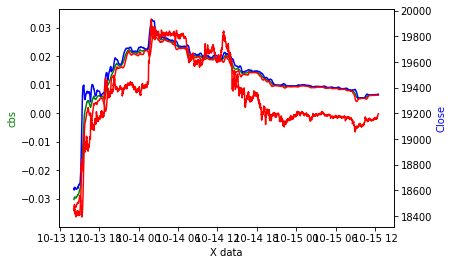

In [238]:
fig, ax1 = plt.subplots()
ax2 = ax1.twinx()
# ax1.plot(.iloc[:100],'g-')
# ax1.plot(dates['cbs_ratio_ma15'].iloc[:1000],'g-')
# ax1.plot(dates['cbs_ratio_ma15_delta'].iloc[:1000],'g-')
ax1.plot(dates['cbs_ratio_ma30'].iloc[100:],'g-')
ax1.plot(dates['cbs_ratio_ma30_u'].iloc[100:],'b-')
ax1.plot(dates['cbs_ratio_ma30_d'].iloc[100:],'r-')
# ax1.plot(dates['cbs_ratio_ma15']-dates['cbs_ratio_ma45'].iloc[:5000],'g-')

# ax2.plot(dates['cum_buy_volume'].iloc[:1000], 'b-')
# ax2.plot(dates['cum_sell_volume'].iloc[:1000], 'b-')
ax2.plot(dates['Close'].iloc[100:], 'r-')

ax1.set_xlabel('X data')
ax1.set_ylabel('cbs', color='g')
ax2.set_ylabel('Close', color='b')
plt.show()

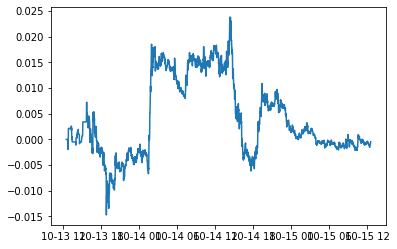

In [132]:
# dates['total_profit_rate_afterFee'].iloc[-1]


In [241]:
sp = 10/100
sl = 1/100
max_k=60
position_list = []
position = 0
cum_ret = 0
k = 0
for index, row in dates.iloc[:max_k].iterrows():
    if(len(dates.loc[:index,])<2):
        pass
    else:
        ret = row['return']
        cum_ret += ret
        k += 1
        position_list.append(position)
        
        # if buy_condition(row) and position == 0:  # buy
        i_index=dates.loc[:index,].index[-2]
        if cross_buy_condition(row,dates.loc[i_index]) and position == 0:  # buy
            position = 1
            k = 0
        # elif sellshort_condition(row) and position == 0:  # sellshort
        elif under_sellshort_condition(row,dates.loc[i_index]) and position == 0:  # sellshort
            position = -1
            k = 0

        elif position == 1 and (sell_condition(row) or cum_ret>sp or k>k_out-1):  # sell
            position = 0
            cum_ret = 0

        elif position == -1 and (buytocover_condition(row) or cum_ret<-sl or k>k_out-1):  # buy to cover
            position = 0
            cum_ret = 0

In [240]:
# dates['cbs_ratio_std'] = dates['cum_buy_sell_ratio'].rolling(window=30, center=False).std()
# dates['upLine'] = dates['cbs_ratio_ma'] + 2*dates['cbs_ratio_std']
# dates['downLine'] = dates['cbs_ratio_ma'] - 2**dates['cbs_ratio_std']
dates['position'] = add_position(dates,
    buy_condition,sellshort_condition,sell_condition,buytocover_condition,
    k_out = 2,sp = np.inf,sl = np.inf,max_k=60)
# dates['position'].plot()

ValueError: Length of values (59) does not match length of index (2881)

In [239]:
def add_position(df,
    buy_condition,sellshort_condition,sell_condition,buytocover_condition,
    k_out = np.inf,sp = np.inf,sl = np.inf,max_k=60):
    sp = 10/100
    sl = 1/100
    
    position_list = []
    position = 0
    cum_ret = 0
    k = 0
    for index, row in df.iloc[:max_k].iterrows():
        if(len(df.loc[:index,])<2):
            pass
        else:
            ret = row['return']
            cum_ret += ret
            k += 1
            position_list.append(position)
            
            # if buy_condition(row) and position == 0:  # buy
            i_index=df.loc[:index,].index[-2]
            if cross_buy_condition(row,df.loc[i_index]) and position == 0:  # buy
                position = 1
                k = 0
            # elif sellshort_condition(row) and position == 0:  # sellshort
            elif under_sellshort_condition(row,df.loc[i_index]) and position == 0:  # sellshort
                position = -1
                k = 0

            elif position == 1 and (sell_condition(row) or cum_ret>sp or k>k_out-1):  # sell
                position = 0
                cum_ret = 0

            elif position == -1 and (buytocover_condition(row) or cum_ret<-sl or k>k_out-1):  # buy to cover
                position = 0
                cum_ret = 0
    return position_list

def cross_buy_condition(row_t,row_t_1):
    c1=row_t['cbs_ratio_ma5']>row_t['cbs_ratio_ma15']
    c2=row_t_1['cbs_ratio_ma5']<row_t_1['cbs_ratio_ma15']
    c3=row_t['cbs_ratio_ma15_delta']>0
    if (c1 and c2 and c3) :
        return True
    return False
def under_sellshort_condition(row_t,row_t_1):
    c1=row_t['cbs_ratio_ma5']<row_t['cbs_ratio_ma15']
    c2=row_t_1['cbs_ratio_ma5']>row_t_1['cbs_ratio_ma15']
    c3=row_t['cbs_ratio_ma15_delta']<0
    if (c1 and c2 and c3) :
        return True
    return False
def buy_condition(row):
    if (row['cbs_ratio_ma5']>row['cbs_ratio_ma15']) and (row['cbs_ratio_ma15_delta']>0):
        return True
    return False
    
def sellshort_condition(row):
    if (row['cbs_ratio_ma5']<row['cbs_ratio_ma15']) and (row['cbs_ratio_ma15_delta']<0):
        return True
    return False

def sell_condition(row):
    # if row['close'] < row['MA10']:
    #     return True
    return False

def buytocover_condition(row):
    # if row['close'] > row['MA10']:
    #     return True
    return False

def get_return(df,fee_rate):
    fee_rate = fee_rate/100
    df['fee_rate'] = df['position'].diff().fillna(0).abs()*fee_rate
    df['profit_rate'] = df['position']*df['return']
    df['profit_rate_afterFee'] = df['profit_rate'] - df['fee_rate']
    
    df['long_return'] = df[df['position'] == 1]['return'].cumsum()
    df['long_return'] = df['long_return'].fillna(method = 'ffill').fillna(0)
    df['short_return'] = df[df['position'] == -1]['return'].cumsum()
    df['short_return'] = df['short_return'].fillna(method = 'ffill').fillna(0)
    
    df['total_profit_rate'] = df['profit_rate'].cumsum()
    df['total_profit_rate_afterFee'] = df['profit_rate_afterFee'].cumsum()
    return df


# test

In [22]:

def backtest(event=pd.DataFrame(), event_name='event_2022_7_27', _print=False, _plot=False, length=15, NumStd=1.5, K_profit=0.06, K_loss=0.03):
    # 'Open', 'High', 'Low', 'Close', 'Volume', 
    # 'twap', 'buy_volume','buy_twap', 'sell_volume', 'sell_twap',
    # 'buy_sell_ratio', 'cum_Volume',
    # 'cum_buy_volume', 'cum_sell_volume', 'cum_buy_sell_ratio'
    # 'cbs_ratio_ma15','cbs_ratio_ma15_delta','cbs_ratio_ma5'
    fund = 10000
    money = 10000
    feeRate = 0
    # event = event_2022_7_27

    # 參數
    # length = 15
    # NumStd = 1.5
    # K_profit = 0.06
    # K_loss = 0.03

    event['MA'] = event['twap'].rolling(window=length, center=False).mean()
    event['STD'] = event['twap'].rolling(window=length, center=False).std()
    event['upLine'] = event['MA'] + NumStd*event['STD']
    event['downLine'] = event['MA'] - NumStd*event['STD']

    BS = None
    buy = []
    sell = []
    sellshort = []
    buytocover = []
    profit_list = [0]
    profit_fee_list = [0]
    profit_fee_list_realized = []
    high = -10**8
    low = 10**8

    df_arr = np.array(event)
    time_arr = np.array(event.index)

    for i in range(len(df_arr)):

        if i == len(df_arr)-1:
            break
            
        ## 進場邏輯
        entryLong = df_arr[i,16] > 0 and df_arr[i,17]>df_arr[i,15]# (ma 15 微分大於0) 且 (ma5>ma15)
        entrySellShort = df_arr[i,16] < 0 and df_arr[i,17]<df_arr[i,15]
        entryCondition = True
        
        ## 出場邏輯
        exitShort = df_arr[i,16] < 0 and df_arr[i,17]<df_arr[i,15]
        exitBuyToCover = df_arr[i,16] > 0 and df_arr[i,17]>df_arr[i,15]

        ## 停利停損邏輯
        if BS == 'B':
            stopProfit = df_arr[i,9] >= df_arr[i,7] * (1+K_profit)
            stopLossMoving = df_arr[i,9] <= high * (1-K_loss)
            stopLoss = df_arr[i,9] <= df_arr[t,7] * (1-K_loss)
            
        elif BS == 'S':
            stopProfit = df_arr[i,7] <= df_arr[i,9] * (1-K_profit)
            stopLossMoving = df_arr[i,7] >= low * (1+K_loss)
            stopLoss = df_arr[i,7] >= df_arr[t,9] * (1+K_loss)
            
        if BS == None:
            profit_list.append(0)
            profit_fee_list.append(0)
            
            if entryLong and entryCondition:
                tempSize = money / df_arr[i+1,7]
                BS = 'B'
                t = i+1
                buy.append(t)
                t1 = time_arr[i+1]
                high = df_arr[i,0]

            elif entrySellShort and entryCondition:
                tempSize = money / df_arr[i+1,9]
                BS = 'S'
                t = i+1
                sellshort.append(t)
                t1 = time_arr[i+1]
                low = df_arr[i,0]
                
        elif BS == 'B':
            profit = tempSize * (df_arr[i+1,0] - df_arr[i,0])
            profit_list.append(profit)
            t2 = time_arr[i+1]
            
            if df_arr[i,0] > high:
                high = df_arr[i,0]

            if exitShort or i == len(df_arr)-2 or stopLossMoving or stopProfit:
            # A = False
            # if A:
                pl_round = tempSize * (df_arr[i+1,9] - df_arr[t,7])
                profit_fee = profit - money*feeRate - (money+pl_round)*feeRate
                profit_fee_list.append(profit_fee)
                sell.append(i+1)
                BS=None
                high = -10**8

                # Realized PnL
                profit_fee_realized = pl_round - money*feeRate - (money+pl_round)*feeRate
                profit_fee_list_realized.append(profit_fee_realized)
                
            else:
                profit_fee = profit
                profit_fee_list.append(profit_fee)
                t1 = time_arr[i+1]
                
        elif BS == 'S':
            profit = tempSize * (df_arr[i,0] - df_arr[i+1,0])
            profit_list.append(profit)
            t2 = time_arr[i+1]

            if df_arr[i,0] < low:
                low = df_arr[i,0]
            
            if exitBuyToCover or i == len(df_arr)-2 or stopLossMoving or stopProfit:
            # A = False
            # if A:
                pl_round = tempSize * (df_arr[t,9] - df_arr[i+1,7])
                profit_fee = profit - money*feeRate - (money+pl_round)*feeRate
                profit_fee_list.append(profit_fee)
                buytocover.append(i+1)
                BS=None
                low = 10**8

                # Realized PnL
                profit_fee_realized = pl_round - money*feeRate - (money+pl_round)*feeRate
                profit_fee_list_realized.append(profit_fee_realized)
    
            else:
                profit_fee = profit
                profit_fee_list.append(profit_fee)
                t1 = time_arr[i+1]            
    equity = pd.DataFrame({'profit':np.cumsum(profit_fee_list)}, index=event.index)
    equity['equity'] = equity['profit'] + fund
    equity['drawdown_percent'] = (equity['equity'] / equity['equity'].cummax()) - 1
    equity['drawdown'] = equity['equity'] - equity['equity'].cummax()
    
    ret = equity['equity'][-1]/equity['equity'][0] - 1
    mdd = abs(equity['drawdown_percent'].min())
    if mdd != 0:
        calmarRatio = ret / mdd
    else:
        calmarRatio = np.nan
    tradeTimes = len(buy)+len(sellshort)

    if len(profit_fee_list_realized) != 0:
        winRate = len([i for i in profit_fee_list_realized if i > 0]) / len(profit_fee_list_realized)
    else:
        winRate = np.nan

    if abs(np.mean([i for i in profit_fee_list_realized if i < 0])) != 0:
        winLossRatio = np.mean([i for i in profit_fee_list_realized if i > 0]) / abs(np.mean([i for i in profit_fee_list_realized if i < 0]))
    else:
        winLossRatio = np.nan

    if _print == True: 
        print(f'<{event_name}>')
        print(f'return: {np.round(ret,4)*100}%')
        print(f'mdd: {np.round(mdd,4)*100}%')
        print(f'calmarRatio: {np.round(calmarRatio,2)}')
        print(f'tradeTimes: {tradeTimes}')
        print(f'winRate: {np.round(winRate,4)*100}%')
        print(f'winLossRatio: {np.round(winLossRatio,2)}')
        print()

    if _plot == True:
        equity.plot(figsize=(12,6), ylabel='PnL')
        event['Close'].plot(alpha=0.7, grid=True, secondary_y=True)
        plt.title(f'Equity Curve {event_name}')
        plt.ylabel('BTC Spot Price')
        plt.show();

    return equity




In [ ]:

warnings.filterwarnings("ignore")

fed_meeting_timelist = ['2022-1-26 19:24', '2022-3-16 19:23', '2022-5-4 19:16', '2022-6-15 19:25', '2022-7-27 19:23', '2022-9-21 19:11']
eco_predict_timelist = ['2021-3-17 17:59', '2021-6-16 17:59', '2021-9-22 17:59', '2021-12-15 18:59']

event_2021_3_17  = pd.read_csv('event/event_2021_3_17.csv', parse_dates=True, index_col='Unnamed: 0')
event_2021_6_16  = pd.read_csv('event/event_2021_6_16.csv', parse_dates=True, index_col='Unnamed: 0')
event_2021_9_22  = pd.read_csv('event/event_2021_9_22.csv', parse_dates=True, index_col='Unnamed: 0')
event_2021_12_15 = pd.read_csv('event/event_2021_12_15.csv', parse_dates=True, index_col='Unnamed: 0')
event_2022_1_26  = pd.read_csv('event/event_2022_1_26.csv', parse_dates=True, index_col='Unnamed: 0')
event_2022_3_16  = pd.read_csv('event/event_2022_3_16.csv', parse_dates=True, index_col='Unnamed: 0')
event_2022_5_4  = pd.read_csv('event/event_2022_5_4.csv', parse_dates=True, index_col='Unnamed: 0')
event_2022_6_15 = pd.read_csv('event/event_2022_6_15.csv', parse_dates=True, index_col='Unnamed: 0')
event_2022_7_27 = pd.read_csv('event/event_2022_7_27.csv', parse_dates=True, index_col='Unnamed: 0')
event_2022_9_21 = pd.read_csv('event/event_2022_9_21.csv', parse_dates=True, index_col='Unnamed: 0')

events = [event_2021_3_17, event_2021_6_16, event_2021_9_22, event_2021_12_15, 
          event_2022_1_26, event_2022_3_16, event_2022_5_4, event_2022_6_15, event_2022_7_27, event_2022_9_21]

for event in events:
    event['buy_sell_ratio'] = event['buy_volume'] / event['sell_volume'] - 1
    event['cum_Volume'] = event['Volume'].cumsum()
    event['cum_buy_volume'] = event['buy_volume'].cumsum()
    event['cum_sell_volume'] = event['sell_volume'].cumsum()
    event['cum_buy_sell_ratio'] = event['cum_buy_volume'] / event['cum_sell_volume'] - 1
    

           
                
    equity = pd.DataFrame({'profit':np.cumsum(profit_fee_list)}, index=event.index)
    equity['equity'] = equity['profit'] + fund
    equity['drawdown_percent'] = (equity['equity'] / equity['equity'].cummax()) - 1
    equity['drawdown'] = equity['equity'] - equity['equity'].cummax()
    
    ret = equity['equity'][-1]/equity['equity'][0] - 1
    mdd = abs(equity['drawdown_percent'].min())
    if mdd != 0:
        calmarRatio = ret / mdd
    else:
        calmarRatio = np.nan
    tradeTimes = len(buy)+len(sellshort)

    if len(profit_fee_list_realized) != 0:
        winRate = len([i for i in profit_fee_list_realized if i > 0]) / len(profit_fee_list_realized)
    else:
        winRate = np.nan

    if abs(np.mean([i for i in profit_fee_list_realized if i < 0])) != 0:
        winLossRatio = np.mean([i for i in profit_fee_list_realized if i > 0]) / abs(np.mean([i for i in profit_fee_list_realized if i < 0]))
    else:
        winLossRatio = np.nan

    if _print == True: 
        print(f'<{event_name}>')
        print(f'return: {np.round(ret,4)*100}%')
        print(f'mdd: {np.round(mdd,4)*100}%')
        print(f'calmarRatio: {np.round(calmarRatio,2)}')
        print(f'tradeTimes: {tradeTimes}')
        print(f'winRate: {np.round(winRate,4)*100}%')
        print(f'winLossRatio: {np.round(winLossRatio,2)}')
        print()

    if _plot == True:
        equity.plot(figsize=(12,6), ylabel='PnL')
        event['Close'].plot(alpha=0.7, grid=True, secondary_y=True)
        plt.title(f'Equity Curve {event_name}')
        plt.ylabel('BTC Spot Price')
        plt.show();

    return equity
result = backtest(event=event_2022_1_26, event_name='event_2022_1_26', _print=True, _plot=False, length=15, NumStd=2, K_profit=0.02, K_loss=0.1)


In [81]:
temp=pd.Series()
for date in dates.columns:
    temp=pd.concat([temp,dates[date]])
#.dt.strftime('%Y-%m-%d').
temp.drop_duplicates().sort_values()#.reset_index(drop=True)

C:\Users\casper\AppData\Local\Temp\ipykernel_15668\1735041714.py:1: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  temp=pd.Series()


0     2021-03-02
0     2021-03-03
0     2021-03-04
1     2021-03-05
1     2021-03-06
         ...    
155   2022-10-11
155   2022-10-12
156   2022-10-13
156   2022-10-14
156   2022-10-15
Length: 496, dtype: datetime64[ns]

In [30]:
symbol1='BTCUSDT'
symbol2='BTCUSDT'
no_action=True
batchsize=20

for e in range(epoch):
    dates=btc_usdt_trades.iloc[(e*batchsize):((e+1)*batchsize-1)]
    start_date=dates.iloc[0]
    end_date=dates.iloc[-1]
    print(f"{e*batchsize}~{(e+1)*batchsize-1}")
    btc_usdt_trade=pd.DataFrame()    
    for i,date in enumerate(dates):
        btc_usdt_trade=pd.concat([btc_usdt_trade,to_kline(symbol1=symbol1,symbol2=symbol2,date=date,no_action=no_action)])
        print(f"{i} date：{len(btc_usdt_trade)}")
    btc_usdt_trade.to_csv(f'.\{symbol1}_merge\{start_date}_{end_date}_{symbol1}')

0~19
2021-02-28
2021-03-01
2021-03-02
2021-03-03
2021-03-04
2021-03-05
2021-03-06
2021-03-07
2021-03-08
2021-03-09
2021-03-10
2021-03-11
2021-03-12
2021-03-13
2021-03-14
2021-03-15
2021-03-16
2021-03-17
2021-03-18
20~39
2021-03-20
2021-03-21
2021-03-22
2021-03-23
2021-03-24
2021-03-25
2021-03-26
2021-03-27
2021-03-28
2021-03-29
2021-03-30
2021-03-31
2021-04-01
2021-04-02
2021-04-03
2021-04-04
2021-04-05
2021-04-06
2021-04-07


KeyboardInterrupt: 